# Assignment 2
## Name - Pranav Gupta
## Roll No. - 2021101095

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import time

### 1. Let's Get Blurry

In [2]:
def conv2D(img, kernel):
    img_height, img_width = img.shape
    k_height, k_width = kernel.shape
    
    # Padding step 
    pad_height = (k_height - 1) // 2
    pad_width = (k_width - 1) // 2

    padded_img = np.pad(img, ((pad_height, pad_height), (pad_width, pad_width)), mode='constant', constant_values=0)
    output = np.zeros((img_height, img_width))
    
    # Perform convolution
    for i in range(img_height):
        for j in range(img_width):
            region = padded_img[i:i+k_height, j:j+k_width]
            output[i, j] = np.sum(region * kernel)
    return output

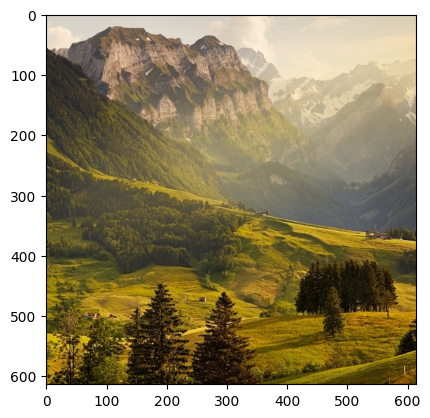

In [3]:
img = cv2.imread('../images/IMG1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)

In [4]:
def meanFilter(img, k=5):
    filter = np.ones((k, k), dtype=np.float64)/(k*k)
    img1 = np.zeros_like(img)
    img1[:, :, 0] = conv2D(img[:, :, 0], filter)
    img1[:, :, 1] = conv2D(img[:, :, 1], filter)
    img1[:, :, 2] = conv2D(img[:, :, 2], filter)
    return img1

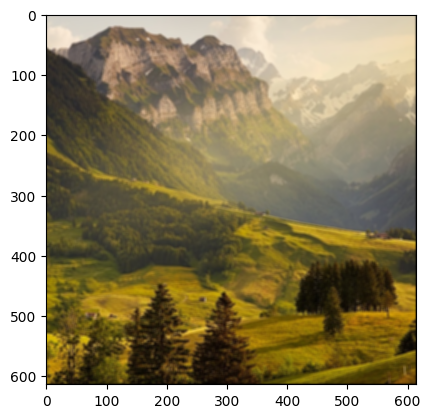

In [5]:
img1 = meanFilter(img, 5)
plt.imshow(img1)

In [6]:
def medianFilter(img, k=5):
    output = np.zeros_like(img)
    for channel in range(3):
        img_height, img_width = img[:, :, channel].shape
        k_height = k_width = k
        
        # Padding step 
        pad_height = (k_height - 1) // 2
        pad_width = (k_width - 1) // 2

        padded_img = np.pad(img[:, :, channel], ((pad_height, pad_height), (pad_width, pad_width)), mode='constant', constant_values=0)
        
        # Perform filtering
        for i in range(img_height):
            for j in range(img_width):
                region = padded_img[i:i+k_height, j:j+k_width]
                output[i, j, channel] = np.median(region)
    return output

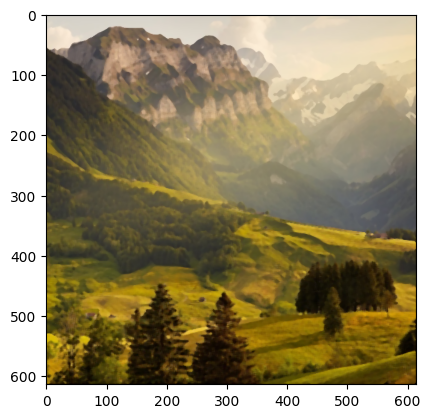

In [7]:
img1 = medianFilter(img, 5)
plt.imshow(img1)

In [8]:
def measure_time(img, func, filterName):
    img_256 = cv2.resize(img, (256, 256))
    img_512 = cv2.resize(img, (512, 512))
    img_1024 = cv2.resize(img, (1024, 1024))
    img_list = [img_256, img_512, img_1024]
    k_l = [3, 5, 7]
    colors = ['r', 'g', 'b']
    dimensions = [256, 512, 1024]
    for i, image in enumerate(img_list):
        l = []
        for k in k_l:
            start = time.perf_counter()
            res = func(image, k)
            end = time.perf_counter()
            t = end-start
            l.append(t)
        plt.plot(k_l, l, marker='o', color=colors[i], linestyle='-', label=f'{filterName} Filter Image Dim = {dimensions[i]} k = {k} Time')

    plt.xlabel('X-axis')
    plt.ylabel('Y-axis')
    plt.title('Time Graph')
    plt.legend()
    plt.show()

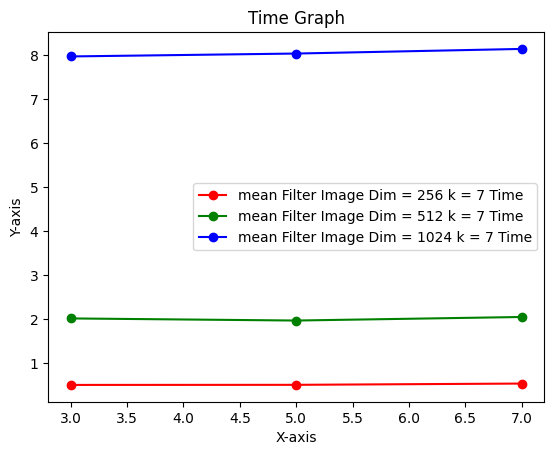

In [9]:
measure_time(img, meanFilter, "mean")

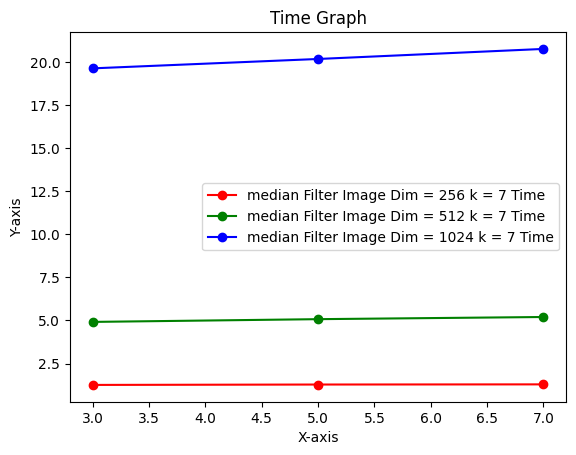

In [10]:
measure_time(img, medianFilter, "median")

*Observations:*
We observe that in case of Mean Filter as the Image Size increases from 256 to 1024, decrease in execution times are witnessed (assuming the same image dimensions and different values of k). It is because of the fact that larger kernel sizes allows the kernel to slide over the image in a faster manner, thus resulting in a drop as kernel size increases, and this effect is more pronounced as image becomes larger. In case of Median Filter, the execution time with different kernel sizes more or less remain the same (assuming the same image dimensions and different values of k), since we are now taking the median of the kernel region, which is basically sliding over the entire image once, which leads to almost same time duration for different kernel sizes in Median Filtering. Furthur, one observation is trivial that as image dimensions increase, the time required to execute the program also increases.

In [11]:
def fastConv2D(image, half_kernel):
    img_height, img_width = image.shape[0], image.shape[1]
    
    integral_img = np.cumsum(np.cumsum(image, axis=0), axis=1)
    filtered_image = np.zeros_like(image, dtype=np.float32)

    for i in range(img_height):
        for j in range(img_width):
            x1, y1 = max(0, i-half_kernel), max(0, j-half_kernel)
            x2, y2 = min(img_height-1, i+half_kernel), min(img_width-1, j+half_kernel)

            count = (x2-x1+1)*(y2-y1+1)
            sum_region = integral_img[x2, y2]-integral_img[x1-1, y2]-integral_img[x2, y1-1]+integral_img[x1-1, y1-1]
            filtered_image[i, j] = sum_region / count
    return filtered_image


def fastMeanFilter(image, k=5):
    half_kernel = k // 2
    filtered_image = fastConv2D(image, half_kernel)
    return filtered_image

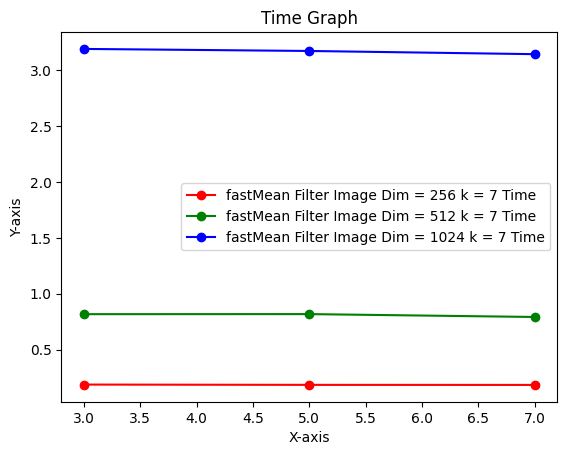

In [12]:
measure_time(img, fastMeanFilter, "fastMean")

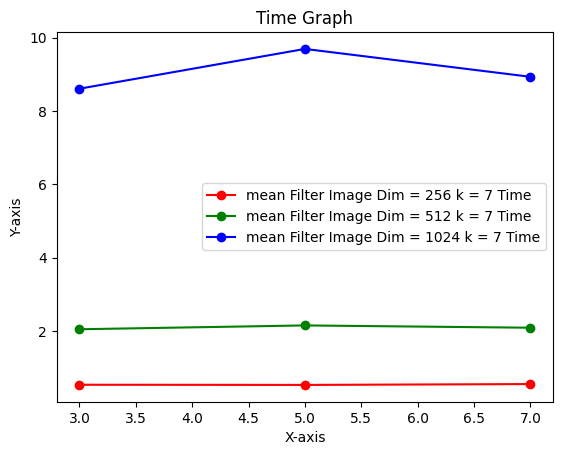

In [13]:
measure_time(img, meanFilter, "mean")

*Observations:*
We observe that not much difference is visible in the execution times in cases of mean and fast mean filters, because more or less the same algorithm is being used in both of the cases. Only the fact that fast mean filters perform the computations faster, which is expected as well. 

### 2. Distribution of the Solution

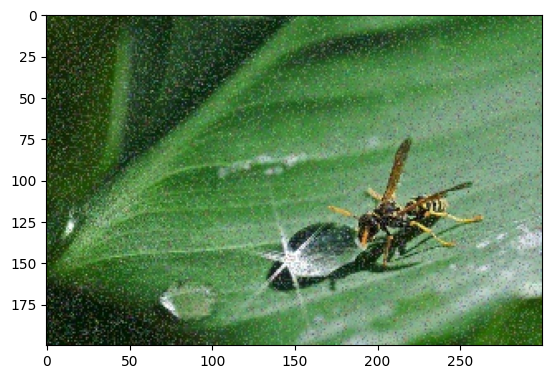

In [14]:
img2 = cv2.imread('../images/IMG2.jpg')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
plt.imshow(img2)

In [15]:
def generateGaussianKernel(size, sigma):
    kernel = np.fromfunction(lambda x, y: (1/(2*np.pi*sigma**2))*np.exp(-((x-(size-1)/2)**2+(y-(size-1)/2)**2)/(2*sigma**2)), (size, size))
    return kernel

def gaussFilter(img, size=7, sigma=1):
    img1 = np.zeros_like(img)
    kernel = generateGaussianKernel(size, sigma)
    kernel = kernel/np.sum(kernel)
    img1[:, :, 0] = conv2D(img[:, :, 0], kernel)
    img1[:, :, 1] = conv2D(img[:, :, 1], kernel)
    img1[:, :, 2] = conv2D(img[:, :, 2], kernel)
    return img1

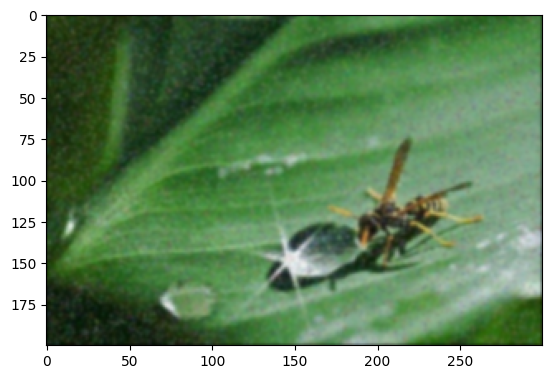

In [16]:
res = gaussFilter(img2, 7, 1)
plt.imshow(res)

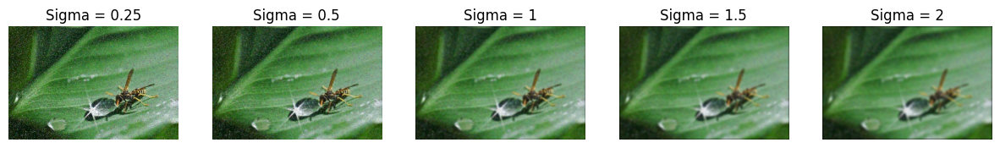

In [17]:
sigma_l = [0.25, 0.5, 1, 1.5, 2]
plt.figure(figsize=(15, 10))
for i, sigma in enumerate(sigma_l):
    plt.subplot(1, 5, i+1)
    res = gaussFilter(img2, 7, sigma)
    plt.title(f'Sigma = {sigma}')
    plt.imshow(res)
    plt.axis('off')

In [18]:
def determine_optimal_sigma(k=7):
    ax = np.linspace(-(k // 2), k // 2, k)
    sigma_values = np.linspace(0.5, 3, 100000)  # Trying values from 0.5 to 3
    optimal_sigma = 0
    best_ratio = 0
    target_area = 0.99
    
    for sigma in sigma_values:
        gauss = np.exp(-0.5 * np.square(ax) / np.square(sigma))
        kernel = np.outer(gauss, gauss)
        kernel_sum = np.sum(kernel)
        
        kernel_ratio = np.sum(kernel[kernel > 0.001]) / kernel_sum
        
        if np.abs(kernel_ratio - target_area) < np.abs(best_ratio - target_area):
            best_ratio = kernel_ratio
            optimal_sigma = sigma
    
    return optimal_sigma

In [19]:
determine_optimal_sigma(7)

0.6015760157601576

Sigma Value of 0.6 as number of sampled points tends to infinity is found to be the most optimal since it gives the best distribution of kernel.

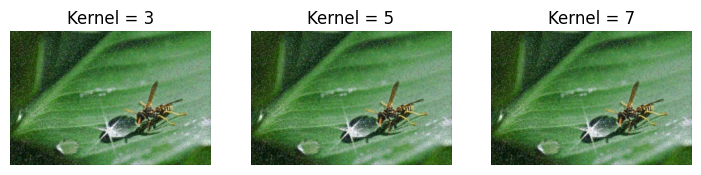

In [20]:
kernel_l = [3, 5, 7]
plt.figure(figsize=(15, 10))
for i, kernel in enumerate(kernel_l):
    plt.subplot(1, 5, i+1)
    res = gaussFilter(img2, kernel, 0.5)
    plt.title(f'Kernel = {kernel}')
    plt.imshow(res)
    plt.axis('off')

*Observations:* We observe that as kernel size increases from 3 to 7, the distinction of image quality decreases which is evident from the case of kernel size = 5 and 7. In case of kernel size = 3, we see that image features are clearer than in case of kernel sizes of 5 and 7.

In [21]:
def bilaterFilter(img, k, sigma_s, sigma_r):
    output = np.zeros_like(img)

    for channel in range(3):
        img_height, img_width = img[:, :, channel].shape
        pad = (k - 1) // 2
        spatial_kernel = np.zeros((k, k))
        
        for i in range(k):
            for j in range(k):
                x = i-pad
                y = j-pad
                spatial_kernel[i, j] = np.exp(-(x**2+y**2)/(2*sigma_s**2))
        
        
        for i in range(img_height):
            for j in range(img_width):
                region = img[max(i-pad, 0):min(i+pad+1, img_height), max(j-pad, 0):min(j+pad+1, img_width), channel]
                center_pixel = img[i, j, channel]
                intensity_kernel = np.exp(-((region - center_pixel) ** 2) / (2 * sigma_r**2))
                combined_kernel = spatial_kernel[:region.shape[0], :region.shape[1]] * intensity_kernel
                combined_kernel /= np.sum(combined_kernel)
                output[i, j, channel] = np.sum(region * combined_kernel)
    
    return output

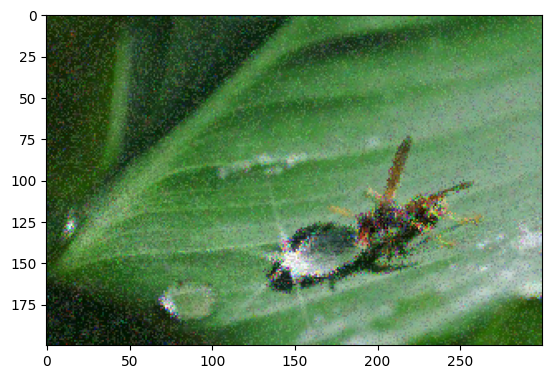

In [22]:
result = bilaterFilter(img2, 11, 1, 1)
plt.imshow(result)

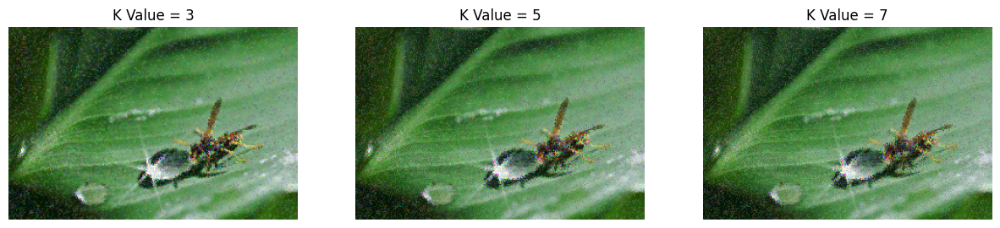

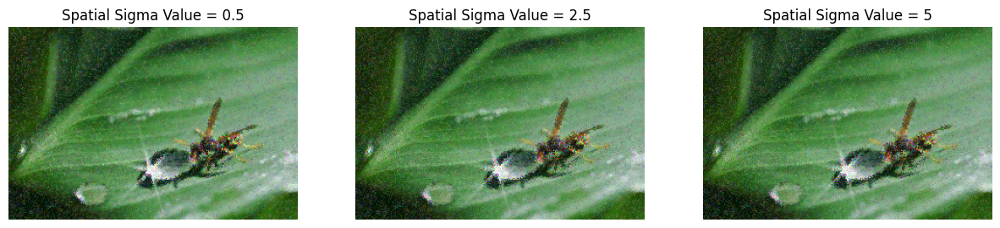

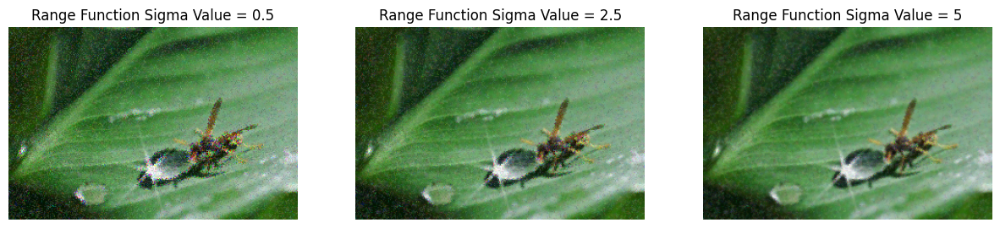

In [23]:
k_list = [3, 5, 7]
sigmas_l = [0.5, 2.5, 5]
sigmar_l = [0.5, 2.5, 5]
plt.figure(figsize=(15, 5))
for i, k in enumerate(k_list):
    plt.subplot(1, 3, i+1)
    result = bilaterFilter(img2, k, 1, 1)
    plt.title(f'K Value = {k}')
    plt.imshow(result)
    plt.axis('off')

plt.figure(figsize=(15, 5))
for i, sigma in enumerate(sigmas_l):
    plt.subplot(1, 3, i+1)
    result = bilaterFilter(img2, 5, sigma, 1)
    plt.title(f'Spatial Sigma Value = {sigma}')
    plt.imshow(result)
    plt.axis('off')

plt.figure(figsize=(15, 5))
for i, sigma in enumerate(sigmar_l):
    plt.subplot(1, 3, i+1)
    result = bilaterFilter(img2, 5, 1, sigma)
    plt.title(f'Range Function Sigma Value = {sigma}')
    plt.imshow(result)
    plt.axis('off')

*Observations:* As the value of kernel size increases from 3 to 7, we see that the objects' distinctiveness in the image decreases because greater kernel sizes lead to greater normalization in the particular region. As the value of Spatial Sigma increases from 0.5 to 5, we see that there is a noticable change in the objects' color background in the image and gradually darkens up as sigma values increase because greater sigma values lead to greater normalization of color in the region. Finally, as the value of Range Sigma increases from 0.5 to 5, we see that there is a noticable decrease in the noise in the image because greater sigma values lead to greater filtering of noise within the region. 

#### *Difference between the outputs of Gaussian and Bilateral Filters*

*Gaussian Filter:*

Weighting function: Uses a Gaussian distribution to determine the weight of each pixel in the neighborhood.
Smoothing: Blurs the image by averaging pixel values based on their proximity to the center pixel.
Preservation: Does not preserve edges well, as it blurs all features, including sharp transitions.
Use cases: General image smoothing, noise reduction, and blurring effects.

*Bilateral Filter:*

Weighting function: Uses a Gaussian distribution for spatial proximity and a Gaussian distribution for intensity similarity.
Smoothing: Blurs the image while preserving edges by considering both pixel location and intensity.
Edge preservation: Better at preserving edges compared to the Gaussian filter.
Use cases: Noise reduction, edge preservation, and texture enhancement.

In summary:
The Gaussian filter is suitable for general image smoothing and noise reduction but may blur edges.
The Bilateral filter is better at preserving edges while reducing noise, making it suitable for tasks that require both smoothing and edge detail.

### 3. Edge of Glory

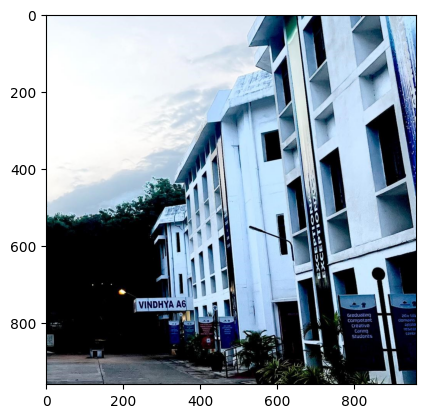

In [24]:
img3 = cv2.imread('../images/IMG3.jpeg')
img3 = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)
plt.imshow(img3)

In [25]:
def convolve_matrix(img, kernel):
    kernel_size = kernel.shape[0]
    pad_size = kernel_size//2
    padded_img = np.pad(img, pad_width=[(pad_size,pad_size),(pad_size,pad_size)])
    rows, cols = padded_img.shape
    filtered_img = np.zeros_like(img, dtype=np.float64)

    
    for i in range(pad_size, rows-pad_size):
        for j in range(pad_size, cols-pad_size):
            sub_mat = padded_img[i-pad_size: i+pad_size+1, j-pad_size: j+pad_size+1]
            val = np.sum(np.multiply(sub_mat, kernel.T))
            filtered_img[i-pad_size, j-pad_size] = val
    return filtered_img


def calcMagnitude(img, filter_x, filter_y):
    l = []
    x_gradient_red = convolve_matrix(img[:, :, 0], filter_x)
    y_gradient_red = convolve_matrix(img[:, :, 0], filter_y)
    x_gradient_blue = convolve_matrix(img[:, :, 1], filter_x)
    y_gradient_blue = convolve_matrix(img[:, :, 1], filter_y)
    x_gradient_green = convolve_matrix(img[:, :, 2], filter_x)
    y_gradient_green = convolve_matrix(img[:, :, 2], filter_y)
    l.append(x_gradient_red)
    l.append(y_gradient_red)
    l.append(x_gradient_blue)
    l.append(y_gradient_blue)
    l.append(x_gradient_green)
    l.append(y_gradient_green)
    l.append(np.sqrt(np.sum(np.square(x_gradient_red))+np.sum(np.square(y_gradient_red))+np.sum(np.square(x_gradient_blue))+np.sum(np.square(x_gradient_blue))+np.sum(np.square(x_gradient_green))+np.sum(np.square(y_gradient_green))))
    return l


def prewittFilter(img, choice):
    prewitt_x = np.array([[-1,0,1],
                          [-1,0,1],
                          [-1,0,1]])
    prewitt_y = np.array([[1,1,1],
                          [0,0,0],
                          [-1,-1,-1]])
    l = calcMagnitude(img, prewitt_x, prewitt_y)
    if choice == 1:
        return l[-1]
    return l


def sobelFilter(img, choice):
    sobel_x = np.array([[-1,0,1],
                        [-2,0,2],
                        [-1,0,1]])
    sobel_y = np.array([[1,2,1],
                        [0,0,0],
                        [-1,-2,-1]])
    l = calcMagnitude(img, sobel_x, sobel_y)
    if choice == 1:
        return l[-1]
    return l


def robertsFilter(img, choice):
    roberts_1 = np.array([[1,0,0],
                        [0,-1,0],
                        [0,0, 0]])
    roberts_2 = np.array([[0,1,0],
                        [-1,0,0],
                        [0,0,0]])
    l = calcMagnitude(img, roberts_1, roberts_2)
    if choice == 1:
        return l[-1]
    return l



def laplacianFilter(img, k):
    kernel = None
    if k == 3:
        kernel = np.array([[0,  1, 0],
                           [1, -4, 1],
                           [0,  1, 0]])
    elif k == 5:
        kernel = np.array([[0,  0, -1,  0, 0],
                           [0, -1, -2, -1, 0],
                           [-1, -2, 16, -2, -1],
                           [0, -1, -2, -1, 0],
                           [0,  0, -1,  0, 0]])
    elif k == 7:
        kernel = np.array([[0,  0,  0,  -1,  0,  0,  0],
                           [0,  0,  -1,  -2,  -1,  0,  0],
                           [0, -1,  -2,  -3,  -2, -1,  0],
                           [-1, -2,  -3,  32,  -3, -2, -1],
                           [0, -1,  -2,  -3,  -2, -1,  0],
                           [0,  0,  -1,  -2,  -1,  0,  0],
                           [0,  0,  0,  -1,  0,  0,  0]])
    img1 = np.zeros_like(img, dtype=np.float64)
    img1[:, :, 0] = conv2D(img[:, :, 0], kernel)
    img1[:, :, 1] = conv2D(img[:, :, 1], kernel)
    img1[:, :, 2] = conv2D(img[:, :, 2], kernel)
    return img1

In [26]:
sobel_gradients = sobelFilter(img3, 1)
sobel_gradients

256439.95747932888

In [27]:
prewitt_gradients = prewittFilter(img3, 1)
prewitt_gradients

189245.00579671844

In [28]:
roberts_gradients = robertsFilter(img3, 2)
threshold = 10
red_gradients = np.sqrt(np.add(np.square(roberts_gradients[0]), np.square(roberts_gradients[1])))
blue_gradients = np.sqrt(np.add(np.square(roberts_gradients[2]), np.square(roberts_gradients[3])))
green_gradients = np.sqrt(np.add(np.square(roberts_gradients[4]), np.square(roberts_gradients[5])))
red_edge_map = (red_gradients > threshold).astype(np.uint8) * 255
blue_edge_map = (blue_gradients > threshold).astype(np.uint8) * 255
green_edge_map = (green_gradients > threshold).astype(np.uint8) * 255

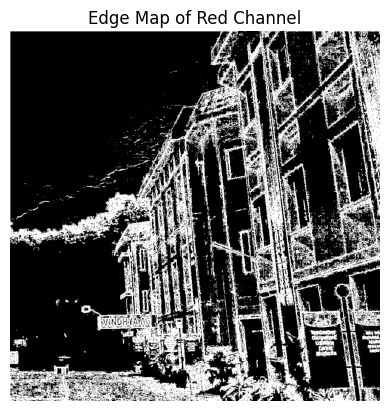

In [29]:
plt.imshow(cv2.convertScaleAbs(red_edge_map), cmap='gray')
plt.title('Edge Map of Red Channel')
plt.axis('off')
plt.show()

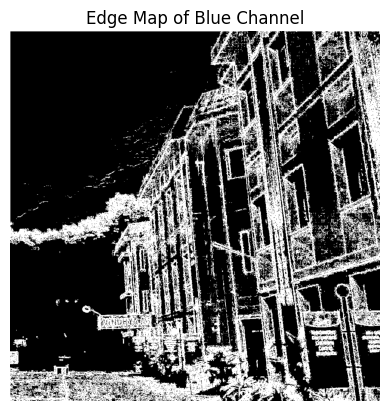

In [30]:
plt.imshow(cv2.convertScaleAbs(blue_edge_map), cmap='gray')
plt.title('Edge Map of Blue Channel')
plt.axis('off')
plt.show()

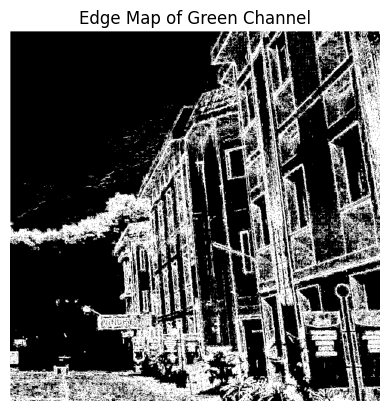

In [31]:
plt.imshow(cv2.convertScaleAbs(green_edge_map), cmap='gray')
plt.title('Edge Map of Green Channel')
plt.axis('off')
plt.show()

In [32]:
def plot(gradients):
    threshold = 10
    red_gradients = np.sqrt(np.add(np.square(gradients[0]), np.square(gradients[1])))
    blue_gradients = np.sqrt(np.add(np.square(gradients[2]), np.square(gradients[3])))
    green_gradients = np.sqrt(np.add(np.square(gradients[4]), np.square(gradients[5])))
    red_edge_map = (red_gradients > threshold).astype(np.uint8) * 255
    blue_edge_map = (blue_gradients > threshold).astype(np.uint8) * 255
    green_edge_map = (green_gradients > threshold).astype(np.uint8) * 255
    resultant_img = np.zeros((red_edge_map.shape[0], red_edge_map.shape[1], 3))
    resultant_img[:, :, 0] = red_edge_map
    resultant_img[:, :, 1] = blue_edge_map
    resultant_img[:, :, 2] = green_edge_map
    x_grads = np.zeros((red_edge_map.shape[0], red_edge_map.shape[1], 3))
    y_grads = np.zeros((red_edge_map.shape[0], red_edge_map.shape[1], 3))
    x_grads[:, :, 0] = gradients[0]
    x_grads[:, :, 1] = gradients[2]
    x_grads[:, :, 2] = gradients[4]
    y_grads[:, :, 0] = gradients[1]
    y_grads[:, :, 1] = gradients[3]
    y_grads[:, :, 2] = gradients[5]
    # x_grads = np.sqrt(np.add(np.square(gradients[0]), np.add(np.square(gradients[2]), np.square(gradients[4]))))
    # y_grads = np.sqrt(np.add(np.square(gradients[1]), np.add(np.square(gradients[3]), np.square(gradients[5]))))
    plt.figure(figsize=(15, 15))
    plt.subplot(3, 3, 1)
    plt.title(f'X-Gradients Red Channel')
    plt.imshow(cv2.convertScaleAbs(gradients[0]), cmap='gray')
    plt.axis('off')
    plt.subplot(3, 3, 2)
    plt.title(f'X-Gradients Green Channel')
    plt.imshow(cv2.convertScaleAbs(gradients[2]), cmap='gray')
    plt.axis('off')
    plt.subplot(3, 3, 3)
    plt.title(f'X-Gradients Blue Channel')
    plt.imshow(cv2.convertScaleAbs(gradients[4]), cmap='gray')
    plt.axis('off')
    plt.subplot(3, 3, 4)
    plt.title(f'Y-Gradients Red Channel')
    plt.imshow(cv2.convertScaleAbs(gradients[1]), cmap='gray')
    plt.axis('off')
    plt.subplot(3, 3, 5)
    plt.title(f'Y-Gradients Green Channel')
    plt.imshow(cv2.convertScaleAbs(gradients[3]), cmap='gray')
    plt.axis('off')
    plt.subplot(3, 3, 6)
    plt.title(f'Y-Gradients Blue Channel')
    plt.imshow(cv2.convertScaleAbs(gradients[5]), cmap='gray')
    plt.axis('off')
    plt.subplot(3, 3, 7)
    plt.title(f'X-Gradients Overall')
    plt.imshow(cv2.convertScaleAbs(x_grads))
    plt.axis('off')
    plt.subplot(3, 3, 8)
    plt.title(f'Y-Gradients Overall')
    plt.imshow(cv2.convertScaleAbs(y_grads))
    plt.axis('off')
    plt.subplot(3, 3, 9)
    plt.title(f'Edge Map')
    plt.imshow(cv2.convertScaleAbs(resultant_img))
    plt.axis('off')
    return x_grads, y_grads, resultant_img

(array([[[ 732.,  747.,  759.],
         [ 976.,  996., 1012.],
         [ 976.,  996., 1012.],
         ...,
         [ 789.,  911.,  990.],
         [ 678.,  791.,  876.],
         [ 410.,  490.,  558.]],
 
        [[   0.,    0.,    0.],
         [   0.,    0.,    0.],
         [   0.,    0.,    0.],
         ...,
         [  -2.,    3.,    7.],
         [  44.,   48.,   49.],
         [  70.,   72.,   71.]],
 
        [[   0.,    0.,    0.],
         [   0.,    0.,    0.],
         [   0.,    0.,    0.],
         ...,
         [   2.,    5.,   10.],
         [  63.,   63.,   66.],
         [  96.,   96.,   96.]],
 
        ...,
 
        [[ -39.,  -39.,  -39.],
         [ -42.,  -42.,  -42.],
         [ -22.,  -22.,  -22.],
         ...,
         [  18.,   22.,   12.],
         [  18.,   30.,   17.],
         [  14.,   29.,   17.]],
 
        [[ -60.,  -60.,  -60.],
         [-109., -109., -109.],
         [-133., -133., -133.],
         ...,
         [ -36.,  -39.,  -46.],
       

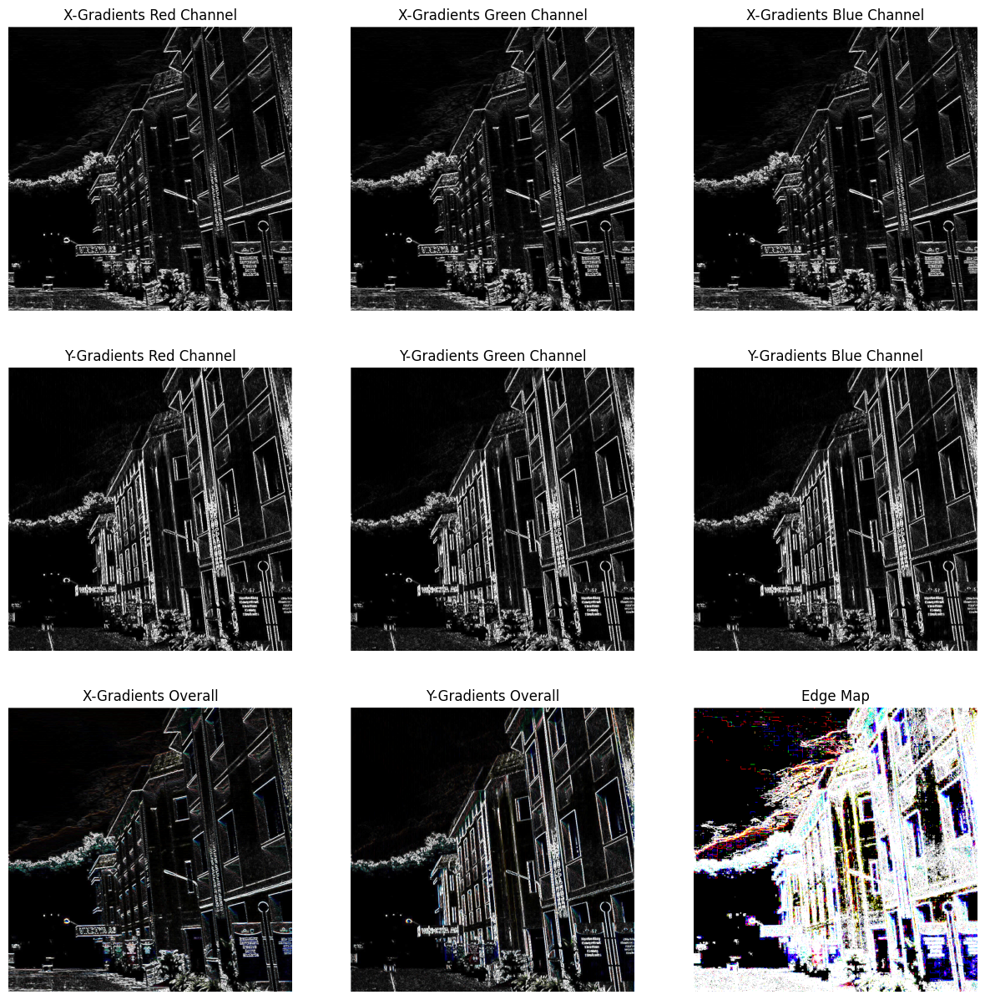

In [33]:
sobel_gradients = sobelFilter(img3, 2)
plot(sobel_gradients)

(array([[[ 488.,  498.,  506.],
         [ 732.,  747.,  759.],
         [ 732.,  747.,  759.],
         ...,
         [ 583.,  674.,  735.],
         [ 500.,  585.,  648.],
         [ 294.,  348.,  393.]],
 
        [[   0.,    0.,    0.],
         [   0.,    0.,    0.],
         [   0.,    0.,    0.],
         ...,
         [   1.,    6.,    7.],
         [  36.,   38.,   40.],
         [  39.,   41.,   40.]],
 
        [[   0.,    0.,    0.],
         [   0.,    0.,    0.],
         [   0.,    0.,    0.],
         ...,
         [   5.,    8.,   10.],
         [  51.,   51.,   54.],
         [  54.,   54.,   54.]],
 
        ...,
 
        [[ -25.,  -25.,  -25.],
         [ -31.,  -31.,  -31.],
         [ -16.,  -16.,  -16.],
         ...,
         [  13.,   17.,    8.],
         [  14.,   23.,   14.],
         [   9.,   18.,   10.]],
 
        [[ -44.,  -44.,  -44.],
         [ -81.,  -81.,  -81.],
         [ -96.,  -96.,  -96.],
         ...,
         [ -22.,  -25.,  -31.],
       

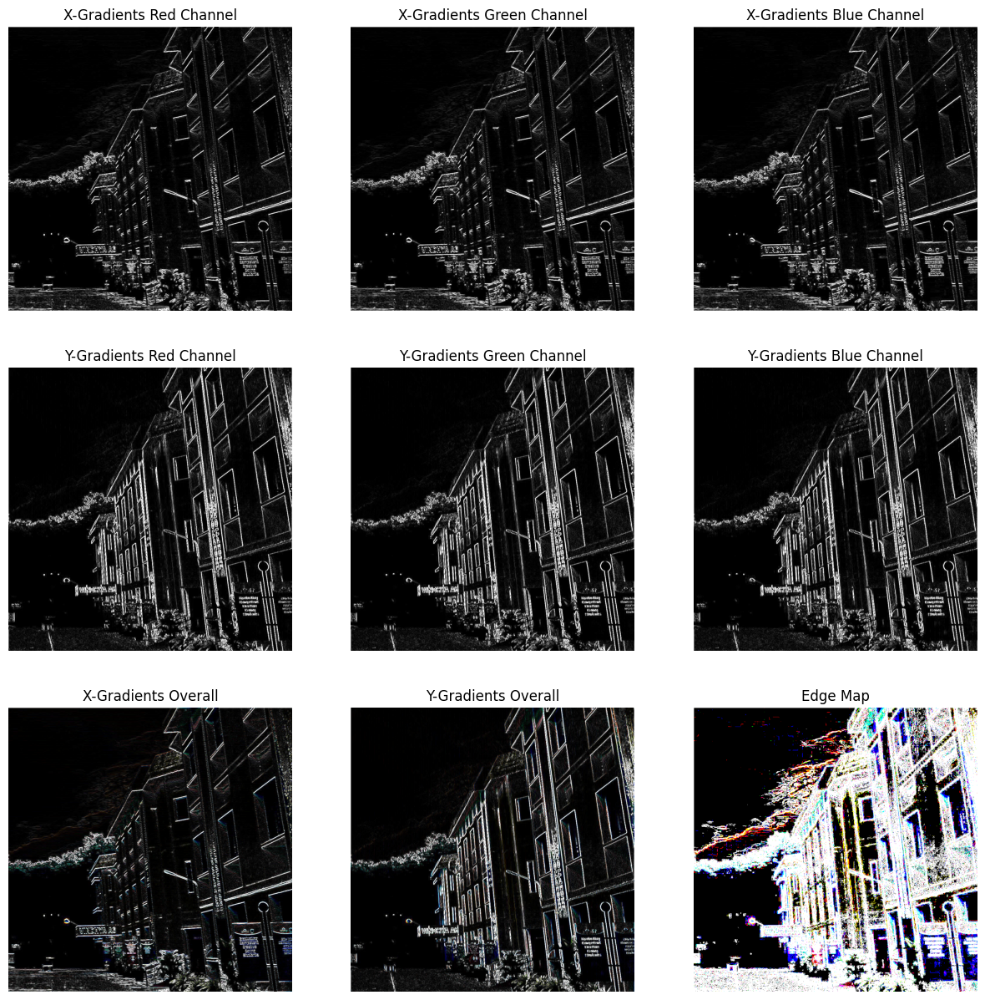

In [34]:
prewitt_gradients = prewittFilter(img3, 2)
plot(prewitt_gradients)

(array([[[-244., -249., -253.],
         [-244., -249., -253.],
         [-244., -249., -253.],
         ...,
         [-206., -237., -255.],
         [-175., -201., -224.],
         [-104., -130., -153.]],
 
        [[-244., -249., -253.],
         [   0.,    0.,    0.],
         [   0.,    0.,    0.],
         ...,
         [  -7.,   -6.,   -3.],
         [  28.,   31.,   27.],
         [  59.,   59.,   59.]],
 
        [[-244., -249., -253.],
         [   0.,    0.,    0.],
         [   0.,    0.,    0.],
         ...,
         [  -4.,   -3.,   -3.],
         [  23.,   26.,   22.],
         [  43.,   45.,   44.]],
 
        ...,
 
        [[ -78.,  -92., -103.],
         [ -26.,  -26.,  -26.],
         [ -21.,  -21.,  -21.],
         ...,
         [  -7.,   -8.,   -5.],
         [  -4.,   -1.,   -2.],
         [   5.,    6.,    9.]],
 
        [[ -53.,  -67.,  -78.],
         [  13.,   13.,   13.],
         [  26.,   26.,   26.],
         ...,
         [  -7.,   -7.,   -6.],
       

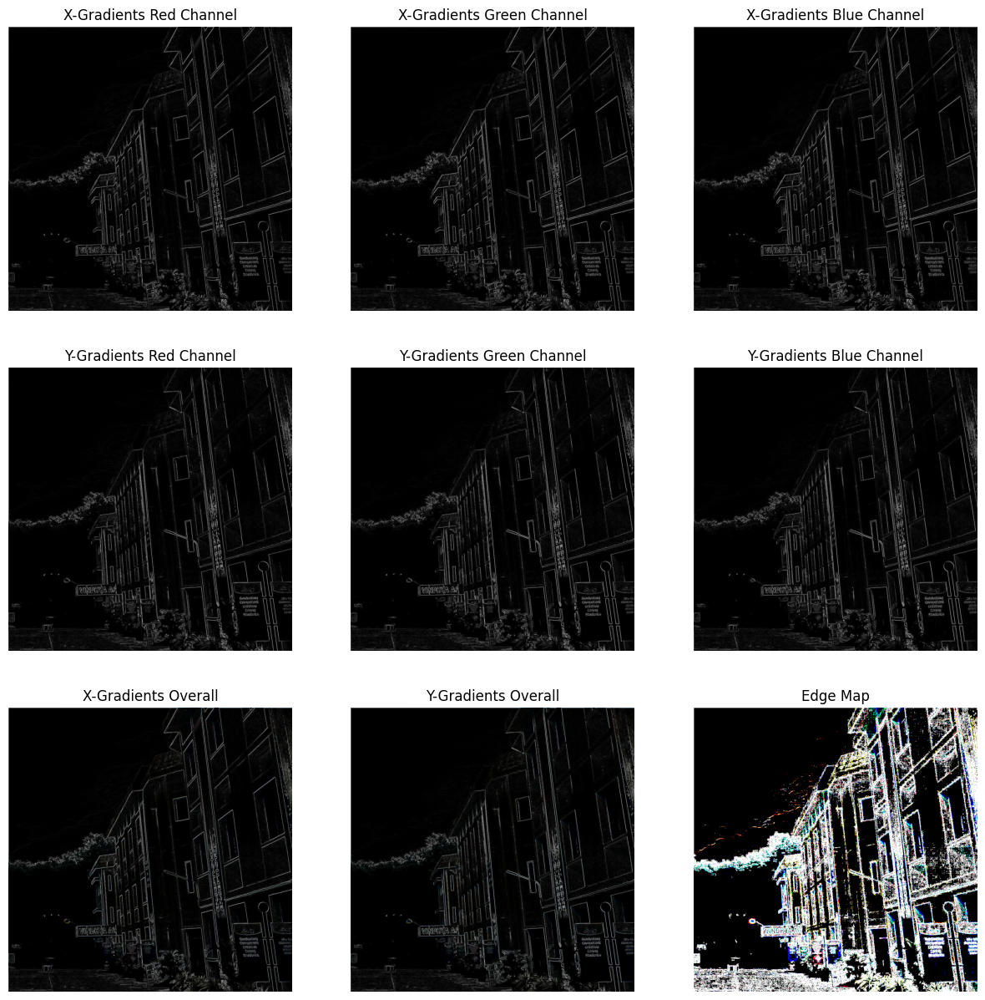

In [35]:
roberts_gradients = robertsFilter(img3, 2)
plot(roberts_gradients)

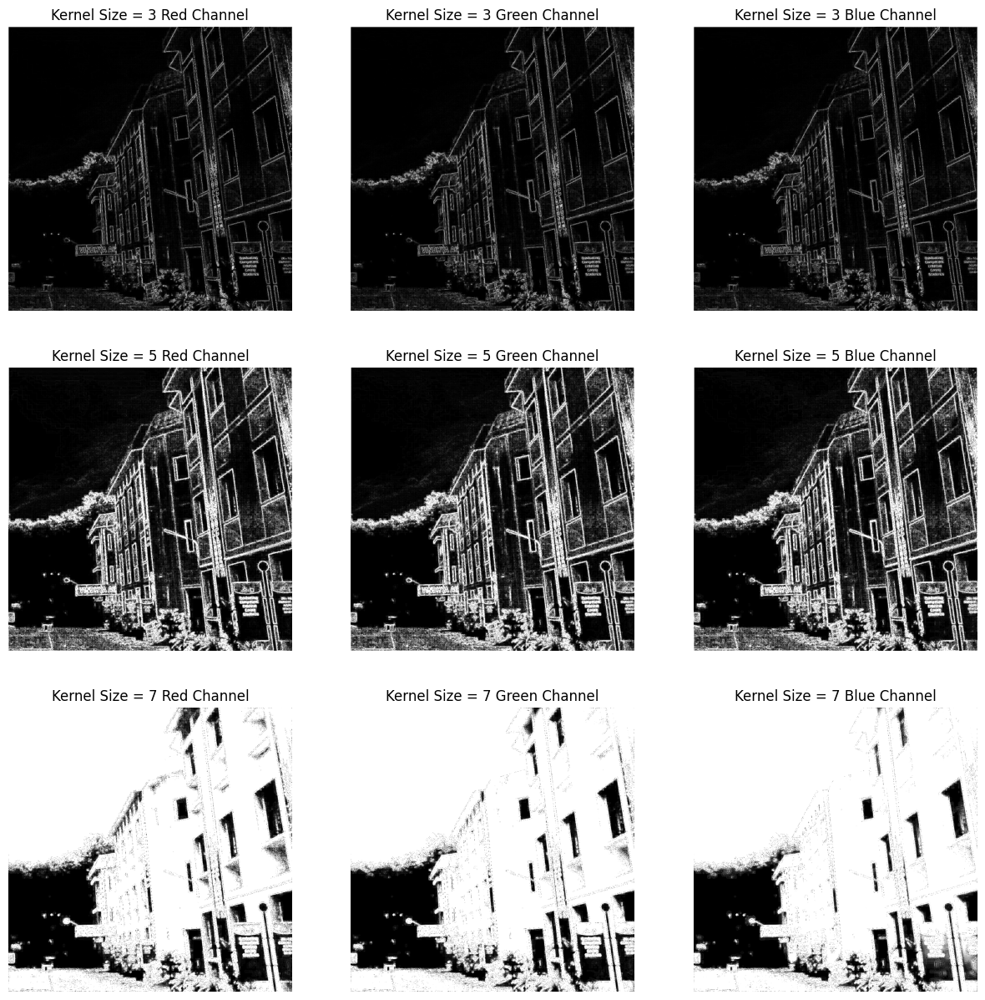

In [36]:
k_l = [3, 5, 7]
plt.figure(figsize=(15, 15))
for i, k in enumerate(k_l):
    result = laplacianFilter(img3, k)
    plt.subplot(3, 3, 3*i+1)
    plt.title(f'Kernel Size = {k} Red Channel')
    plt.imshow(cv2.convertScaleAbs(result[:, :, 0]), cmap='gray')
    plt.axis('off')
    plt.subplot(3, 3, 3*i+2)
    plt.title(f'Kernel Size = {k} Green Channel')
    plt.imshow(cv2.convertScaleAbs(result[:, :, 1]), cmap='gray')
    plt.axis('off')
    plt.subplot(3, 3, 3*i+3)
    plt.title(f'Kernel Size = {k} Blue Channel')
    plt.imshow(cv2.convertScaleAbs(result[:, :, 2]), cmap='gray')
    plt.axis('off')

We observe that as Kernel Size increases, Laplacian Filter is able to detect start contrasts in image pixel intensities but cannot account for the robustness of the gradients in a local region, since it is too sensitive. So, results comparable to those with other filters are obtained in the case of Kernel Size=3 only.

When varying the kernel size in the Laplacian filter, the following effects can be observed:

1. Small Kernel Size (e.g., 3x3):
A smaller kernel focuses on more localized areas of the image.
It enhances fine details, making small edges and sharp transitions in the image more pronounced.
However, noise and minor artifacts may also be amplified due to the sensitivity of the filter to small details.
2. Medium Kernel Size (e.g., 5x5):
A moderate kernel balances between sharpening fine details and ignoring minor noise.
It produces a more refined edge enhancement effect, highlighting important structural elements while reducing the amplification of noise compared to smaller kernels.
The image retains sharpness without looking too harsh.
3. Large Kernel Size (e.g., 7x7 or larger):
A larger kernel size smooths out smaller details, focusing more on the larger structures and transitions in the image.
The sharpening effect becomes subtler, and fine details may be lost, but the larger edges and overall shape are more clearly defined.
Less noise is amplified, leading to a cleaner, smoother appearance, though at the expense of some detail loss.
In general, increasing the kernel size makes the Laplacian filter less sensitive to fine details and noise, producing smoother results but with less aggressive sharpening of small features.

*Observations:*
Each of the edge detection filters—Sobel, Prewitt, Roberts, and Laplacian—has distinct characteristics in terms of how it responds to different types of edges.

Notable Obsrvations:
1. Sobel: Best for detecting strong, smooth edges in horizontal and vertical directions. Less noise-sensitive.
2. Prewitt: Similar to Sobel but slightly less robust, good for general edge detection.
3. Roberts: Best for detecting fine, sharp edges, especially diagonal edges, but more noise-sensitive.
4. Laplacian: Best for detecting edges in all directions and fine details, but very noise-sensitive. It is useful for identifying detailed structure and intersection points, but it can exaggerate noise and may require pre-smoothing.


Conclusion:
For clean images and general edge detection, Sobel and Prewitt are good choices, with Sobel being slightly more noise-resistant.
For fine, diagonal edges, Roberts excels but may require noise handling.
For detecting detailed and complex edge structures in all directions, Laplacian is ideal, but it should be combined with smoothing techniques to reduce noise sensitivity.

### 4. Sharpen Up

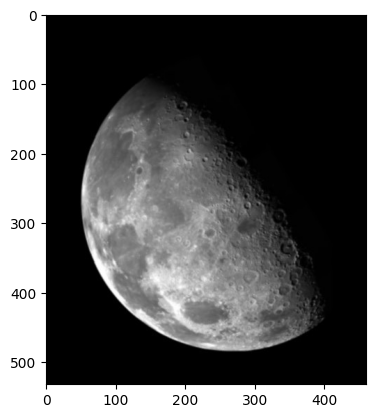

In [37]:
img4 = cv2.imread('../images/IMG4.png')
img4 = cv2.cvtColor(img4, cv2.COLOR_BGR2RGB)
plt.imshow(img4)

In [38]:
def unsharpMask(img, k, sigma):
    blurred_img = gaussFilter(img, k, sigma)
    mask = img - blurred_img
    sharpened_img = img + mask
    sharpened_img = np.clip(sharpened_img, 0, 255)
    return sharpened_img.astype(np.uint8)


def highboostFilter(img, k, sigma, A):
    blurred_img = gaussFilter(img, k, sigma)
    mask = img - blurred_img
    sharpened_img = img + A*mask
    sharpened_img = np.clip(sharpened_img, 0, 255)
    return sharpened_img.astype(np.uint8)

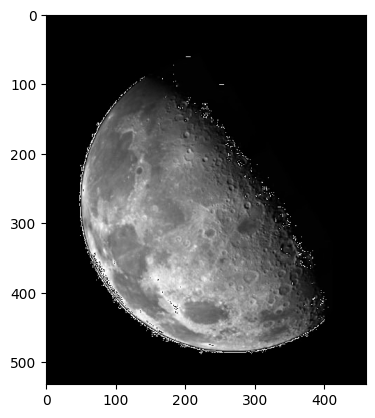

In [39]:
result = unsharpMask(img4, 3, 1)
plt.imshow(result)

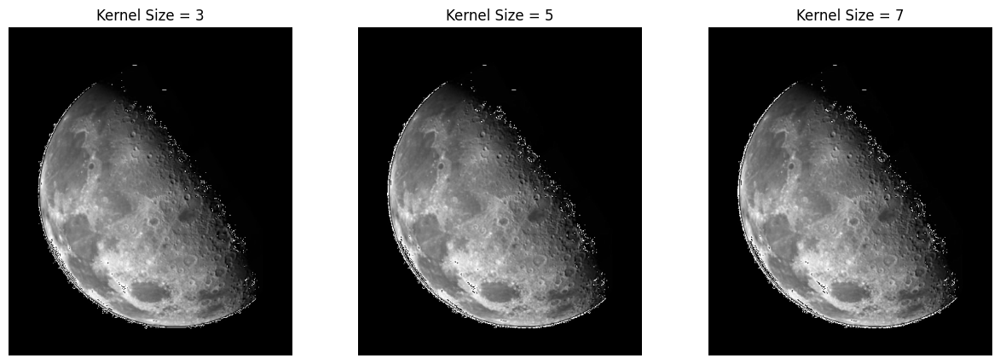

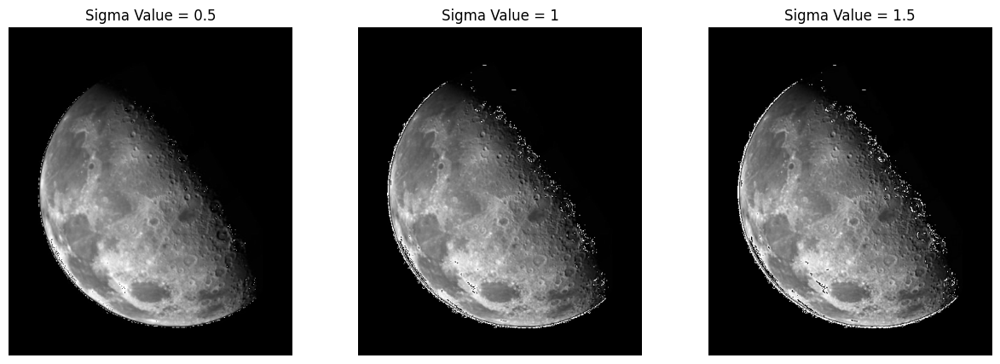

In [40]:
k_l = [3, 5, 7]
plt.figure(figsize=(15, 5))
for i, k in enumerate(k_l):
    result = unsharpMask(img4, k, 1)
    plt.subplot(1, 3, i+1)
    plt.title(f'Kernel Size = {k}')
    plt.imshow(result)
    plt.axis('off')

sigma_l = [0.5, 1, 1.5]
plt.figure(figsize=(15, 5))
for i, sigma in enumerate(sigma_l):
    result = unsharpMask(img4, 5, sigma)
    plt.subplot(1, 3, i+1)
    plt.title(f'Sigma Value = {sigma}')
    plt.imshow(result)
    plt.axis('off')

Roles of Kernel Size and Sigma values in Unsharp Masking:


1. Kernel Size (k):

    Small kernel size (e.g., 3x3 or 5x5): A smaller kernel focuses on local details and applies sharpening over small regions.
It enhances finer details but may introduce noise or artifacts if over-sharpened.
Result: The image appears sharper with more pronounced edges, but small features (like noise) can also be exaggerated.

    Large kernel size (e.g., 15x15 or 21x21): A larger kernel smooths out larger areas, applying sharpening more broadly.
It reduces the impact of fine details and focuses on enhancing larger structures.

Result: The sharpening effect is more subtle, leading to smoother sharpening with less noise, but small details might get blurred.

2. Standard Deviation (σ):
    Small σ (e.g., 0.5 or 1): A small σ applies minimal blurring in the Gaussian filter, so the mask (blurred version of the image) closely resembles the original image.
    Result: The sharpening effect is strong, creating very sharp edges and high contrast between edges and surrounding areas, but it can make the image look too harsh or artificial.

    Large σ (e.g., 2 or 3): A larger σ applies more blurring in the Gaussian filter, so the mask becomes more smooth.
    Result: The sharpening effect is milder and more natural, but some fine details may be lost, leading to a softer sharpening effect.

Combined Effect:

Small kernel + small σ: Produces aggressive sharpening, making edges highly pronounced, but also introduces noise.

Large kernel + large σ: Results in a more subtle, softer sharpening effect with less noise enhancement.

In general, larger kernels and higher σ values provide smoother, less aggressive sharpening, while smaller kernels and lower σ values provide stronger, more localized sharpening at the risk of noise amplification.

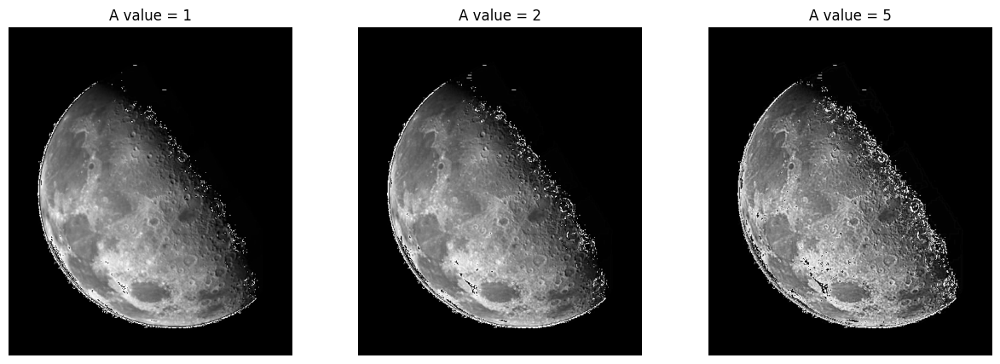

In [41]:
A_l = [1, 2, 5]
plt.figure(figsize=(15, 5))
for i, A in enumerate(A_l):
    result = highboostFilter(img4, 5, 1, A)
    plt.subplot(1, 3, i+1)
    plt.title(f'A value = {A}')
    plt.imshow(result)
    plt.axis('off')

As the A value increases, the image is sharpened more in comparison to the original image. We see that the boundaries of the lunar surface are getiing more sharpened, highlighting the fact that it is a region of stark contrast of gradients in the image. A value also has a contribution towards brightening up of whiter regions and darkening up of darker regions, which leads to increased response of sharpness in the image.

(-0.5, 459.5, 531.5, -0.5)

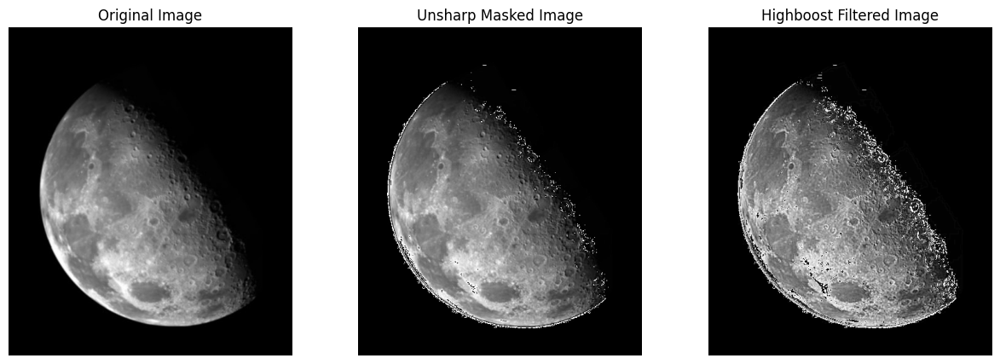

In [42]:
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.title(f'Original Image')
plt.imshow(img4)
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title(f'Unsharp Masked Image')
plt.imshow(unsharpMask(img4, 5, 1))
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title(f'Highboost Filtered Image')
plt.imshow(highboostFilter(img4, 5, 1, 5))
plt.axis('off')

When comparing unsharp masking and highboost filtering for enhancing fine details, both methods have distinct approaches, but highboost filtering generally provides better results for enhancing fine details. Here's why:

1. Unsharp Masking
How it works: Unsharp masking enhances an image by subtracting a blurred version (low-pass filtered) of the image from the original. This emphasizes the high-frequency components (edges and fine details), making the image appear sharper.

Control over detail enhancement: The level of detail enhancement is controlled by the scaling factor k, but it's generally fixed. The method is simple and works well for moderate sharpening.
Effectiveness: Unsharp masking enhances edge contrast and fine details but can quickly introduce noise or artifacts if over-applied. It primarily focuses on enhancing small variations in intensity, so it may not provide strong control over finer detail sharpening beyond basic edge enhancement.


2. Highboost Filtering
How it works: Highboost filtering is an extension of unsharp masking. It allows you to amplify the high-frequency components of the image more aggressively. In addition to subtracting the blurred image, highboost filtering applies a "boost factor"  A to the original image, which allows for better control over detail enhancement. The method enhances fine details more aggressively while maintaining overall image quality.
Effectiveness: Highboost filtering is better at enhancing fine details and subtle textures because the boost factor allows for a stronger enhancement without introducing as much noise as unsharp masking when appropriately tuned.


Comparison:
Control over enhancement: Highboost filtering provides more control over the sharpening process, as the boost factor can be tuned to achieve stronger or softer enhancement, making it better suited for enhancing very fine details.
Detail enhancement: Highboost filtering allows for greater amplification of high-frequency details, making it more effective for images where subtle textures, intricate patterns, or fine edges need to be sharpened.
Risk of noise: Both methods may introduce noise, but highboost filtering’s flexibility allows for a more balanced enhancement, whereas unsharp masking can lead to more noticeable artifacts when pushed to enhance fine details.
Conclusion:
Highboost filtering offers more precision and better performance for enhancing intricate textures and details without significantly increasing noise.

### 5. Rain Rain Go Away

(-0.5, 259.5, 257.5, -0.5)

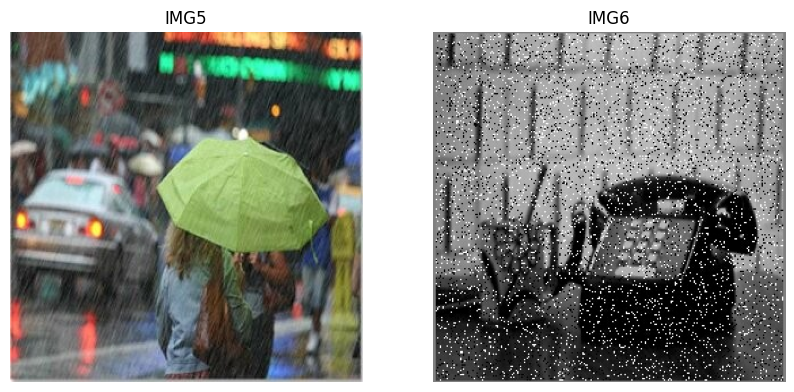

In [43]:
img5 = cv2.imread('../images/IMG5.jpg')
img5 = cv2.cvtColor(img5, cv2.COLOR_BGR2RGB)
img6 = cv2.imread('../images/IMG6.png')
img6 = cv2.cvtColor(img6, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title(f'IMG5')
plt.imshow(img5)
plt.axis('off')
plt.subplot(1, 2, 2)
plt.title(f'IMG6')
plt.imshow(img6)
plt.axis('off')

In [44]:
k_l = [3, 5, 7]
sigmas_l = [0.5, 2, 4]
sigmar_l = [0.5, 2, 4]

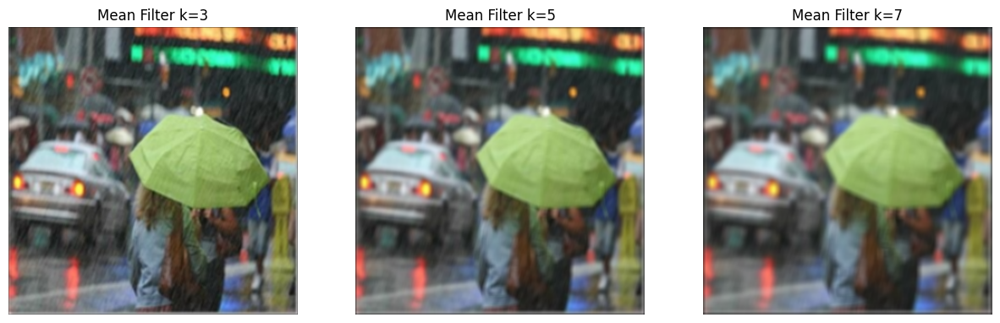

In [45]:
plt.figure(figsize=(15, 5))
for i, k in enumerate(k_l):
    res = meanFilter(img5, k)
    plt.subplot(1, 3, i+1)
    plt.title(f'Mean Filter k={k}')
    plt.imshow(res)
    plt.axis('off')

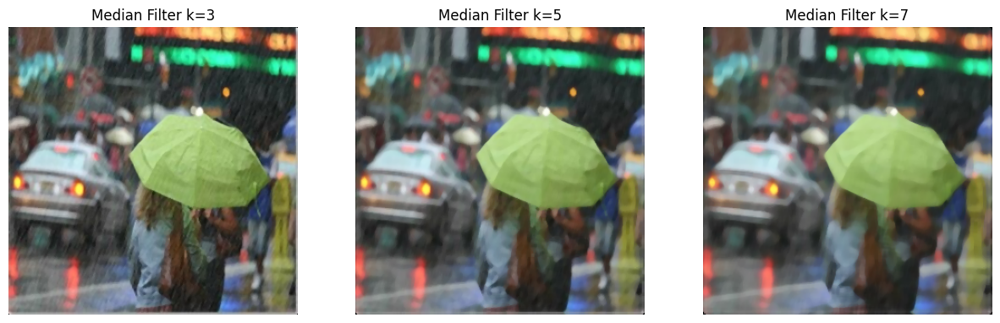

In [46]:
plt.figure(figsize=(15, 5))
for i, k in enumerate(k_l):
    res = medianFilter(img5, k)
    plt.subplot(1, 3, i+1)
    plt.title(f'Median Filter k={k}')
    plt.imshow(res)
    plt.axis('off')

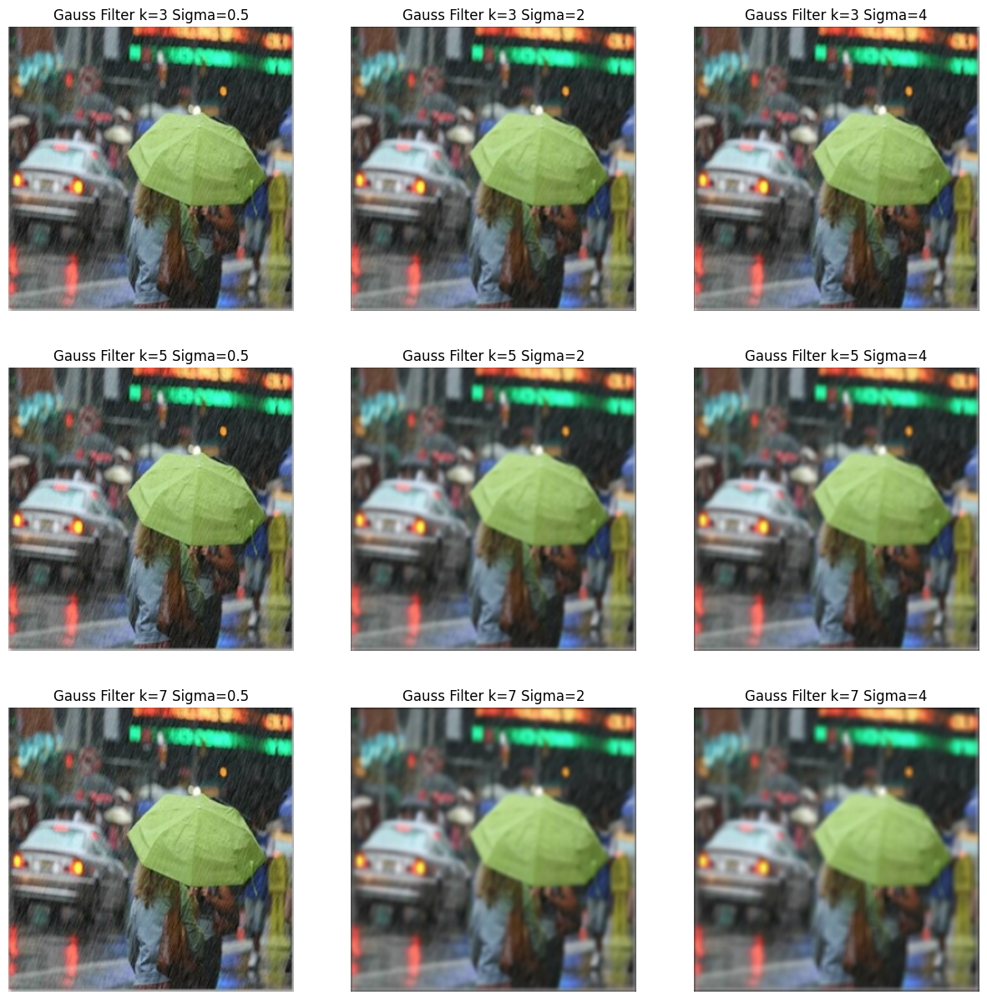

In [47]:
plt.figure(figsize=(15, 15))
for i, k in enumerate(k_l):
    for j, sigma_r in enumerate(sigmar_l):
        plt.subplot(3, 3, 3*i+j+1)
        res = gaussFilter(img5, k, sigma_r)
        plt.title(f'Gauss Filter k={k} Sigma={sigma_r}')
        plt.imshow(res)
        plt.axis('off')

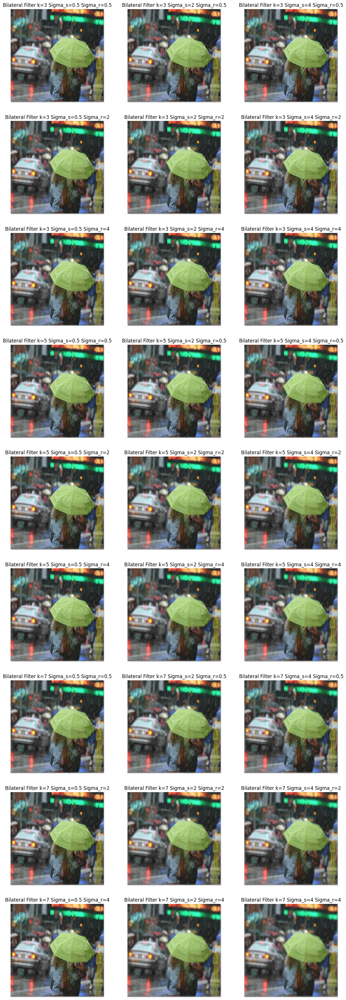

In [48]:
plt.figure(figsize=(15, 45))
for i, k in enumerate(k_l):
    for j, sigma_r in enumerate(sigmar_l):
        for index, sigma_s in enumerate(sigmas_l):
            plt.subplot(9, 3, 9*i+3*j+index+1)
            res = bilaterFilter(img5, k, sigma_s, sigma_r)
            plt.title(f'Bilateral Filter k={k} Sigma_s={sigma_s} Sigma_r={sigma_r}')
            plt.imshow(res)
            plt.axis('off')

##### *Best Parameters for each Filter*
*Mean and Median Filters:* As k increases, image is blurred but the rain is also cleared from the image. In order to make the rain "go away", we accept degrade in quality of the image and pick k=7 so that rain "goes away" from the image.

*Gauss Filter:* In this case too the above reasoning follows with value of k and for sigma values, as sigma increases, rain disappears but image is blurred. The closest we can get to the target image is the image corresponding to k=7 and sigma=2.

*Bilateral Filter:* In this case too the above reasoning follows with value of k and for sigma values. The closest we can get to the target image is the image corresponding to k=7, spatial sigma=4 and range sigma=4.

Gaussian Filter with the specific Hyperparameters seem to be the best because, Bilateral Filtering eith these values is leading to smoothening of image simultaneously, which again adds rain back to the image, which is not the case with Gaussian Filtering, and with the particular hyperparameters, we can get as closest to the target image with these set of hyperparameters.

*In IMG6 there is Salt and Pepper Noise. This noise can easily be filtered using a Median Filter of appropriate kernel.*

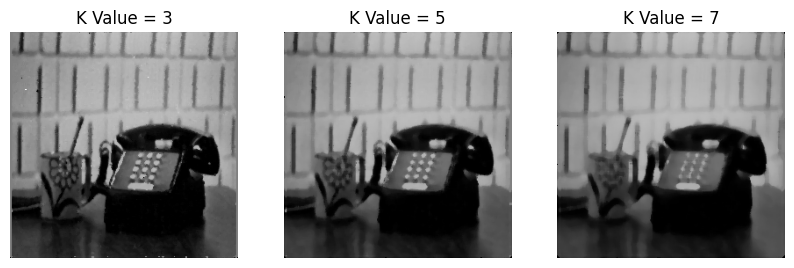

In [49]:
k_l = [3, 5, 7]
plt.figure(figsize=(10, 5))
for i, k in enumerate(k_l):
    result = medianFilter(img6, k)
    plt.subplot(1, 3, i+1)
    plt.title(f'K Value = {k}')
    plt.imshow(result)
    plt.axis('off')

In the above methodology, we see that as k increases, the quality of the image degrades because each pixel is kept as median of the region in which it is present. In case of k=3, some noise is present in the image but image looks very clear. For k=5, no noise is there, but image quality degrades. In k=7, image quality degrades heavily without any noticable change in noise of the image. Thus, there is a tradeoff involved.

### 6. Transform and Conquer

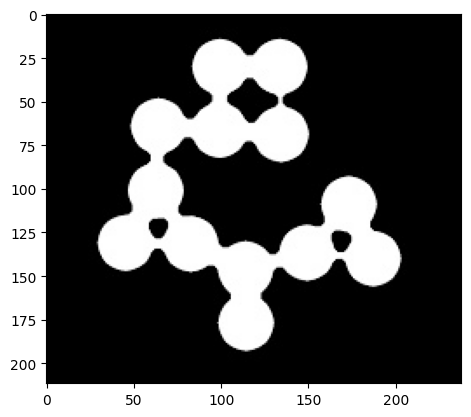

In [50]:
img7 = cv2.imread('../images/IMG7.jpg', 0)
plt.imshow(cv2.cvtColor(img7, cv2.COLOR_GRAY2RGB))

In [51]:
def create_ellipse_kernel(size):
    y, x = np.ogrid[:size, :size]
    center = (size - 1) / 2
    ellipse_mask = (x - center)**2 + (y - center)**2 <= (center)**2
    return ellipse_mask.astype(np.uint8)


def erosion(img, kernel):
    img1 = np.zeros_like(img)
    img_padded = np.pad(img, pad_width=kernel.shape[0]//2, mode='constant', constant_values=255)
    
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            region = img_padded[i: i+kernel.shape[0], j: j+kernel.shape[1]]
            img1[i, j] = np.min(region[kernel == 1])
    return img1


def dilation(img, kernel):
    img1 = np.zeros_like(img)
    img_padded = np.pad(img, pad_width=kernel.shape[0]//2, mode='constant', constant_values=0)
    
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            region = img_padded[i: i+kernel.shape[0], j: j+kernel.shape[1]]
            img1[i, j] = np.max(region[kernel == 1])
    return img1

In [52]:
def erode(img, k=3):
    kernel = create_ellipse_kernel(k)
    img1 = erosion(img, kernel)
    return img1


def dilate(img, k=3):
    kernel = create_ellipse_kernel(k)
    img1 = dilation(img, kernel)
    return img1

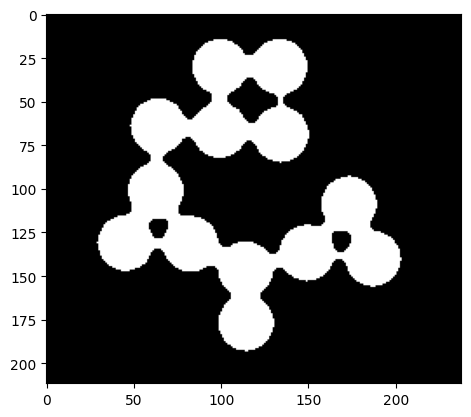

In [53]:
## Apply binarization to the image
initial_conv = np.where((img7 <= 127), img7, 255)
final_conv = np.where((initial_conv > 127), initial_conv, 0)
plt.imshow(final_conv, cmap='gray')

(-0.5, 237.5, 211.5, -0.5)

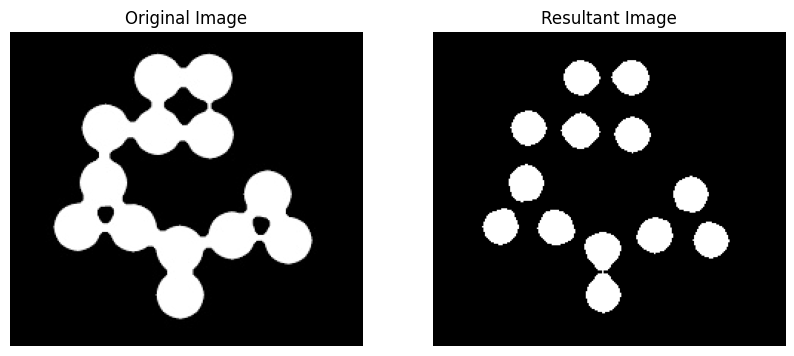

In [54]:
## Apply Erosion to the Image
eroded_img = erode(final_conv, 21)
## Apply Dilation to the Image
dilated_img = dilate(eroded_img, 13)
dilated_img[np.where(dilated_img == 1)] = 255

plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(img7, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(dilated_img, cmap='gray')
plt.title('Resultant Image')
plt.axis('off')

Steps taken in the above are as follows: 

1. Binarization:
Pixels with intensity values less than or equal to 127 are set to 0 (black), and the rest are set to 255 (white).

2. Erosion:
Erosion shrinks objects in the image, effectively separating touching objects. The size of the structuring element determines the amount of erosion applied.

3. Dilation:
Dilation expands objects in the image, helping to restore the original size of the separated objects. The size of the structuring element determines the amount of dilation applied.

4. Conversion to 255:
This ensures that the final image is displayed in a visually understandable format.


Overall Explanation:
The code first converts the grayscale image into a binary image to simplify the subsequent operations. Then, erosion is applied to separate touching objects by shrinking them. Finally, dilation is applied to restore the size of the separated objects and make them more visible. The combination of these morphological operations effectively separates touching coins in the image.

Key Points:

The choice of structuring element sizes for erosion and dilation is crucial. Larger sizes can lead to more aggressive separation, while smaller sizes can result in less separation.
The specific values used for the threshold in binarization and the structuring element sizes may need to be adjusted based on the characteristics of the input image.
Additional morphological operations or filtering techniques might be necessary for complex images or images with noise.

(-0.5, 605.5, 287.5, -0.5)

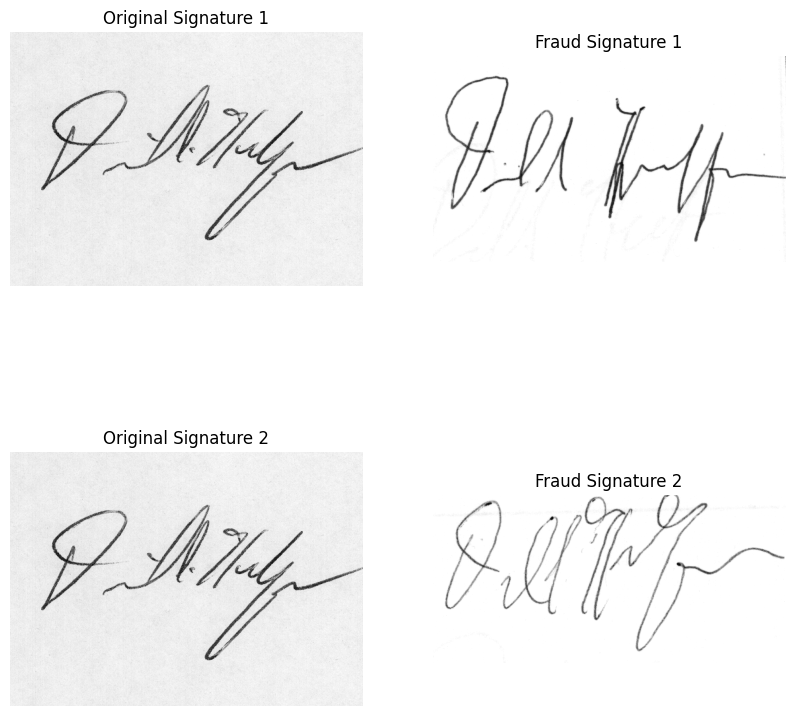

In [55]:
orig_sig1 = cv2.imread('../images/original_10_1.png', 0)
fraud_sig1 = cv2.imread('../images/forgeries_10_1.png', 0)
orig_sig2 = cv2.imread('../images/original_10_10.png', 0)
fraud_sig2 = cv2.imread('../images/forgeries_10_10.png', 0)
plt.figure(figsize=(10, 10))
plt.subplot(2, 2, 1)
plt.imshow(orig_sig1, cmap='gray')
plt.title('Original Signature 1')
plt.axis('off')
plt.subplot(2, 2, 2)
plt.imshow(fraud_sig1, cmap='gray')
plt.title('Fraud Signature 1')
plt.axis('off')
plt.subplot(2, 2, 3)
plt.imshow(orig_sig1, cmap='gray')
plt.title('Original Signature 2')
plt.axis('off')
plt.subplot(2, 2, 4)
plt.imshow(fraud_sig2, cmap='gray')
plt.title('Fraud Signature 2')
plt.axis('off')

In [56]:
from skimage import io, color
from skimage.morphology import skeletonize
from skimage.util import invert

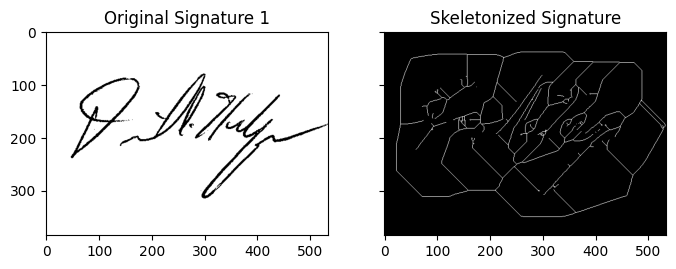

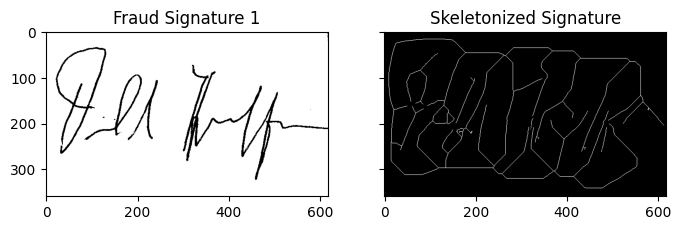

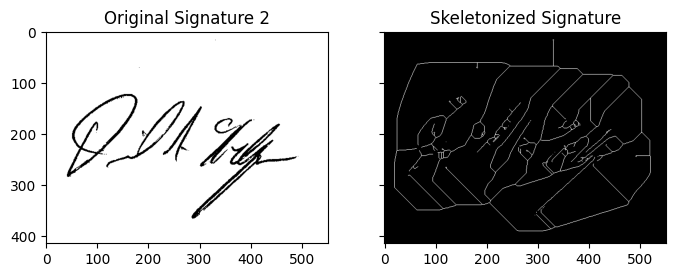

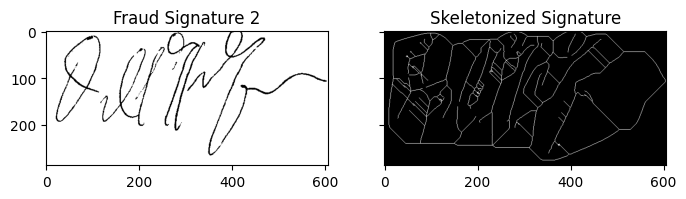

In [57]:
images = [orig_sig1, fraud_sig1, orig_sig2, fraud_sig2]
img_names = ["Original Signature 1", "Fraud Signature 1", "Original Signature 2", "Fraud Signature 2"]
for i, image in enumerate(images):
    binary_signature = image < 200
    binary_signature = invert(binary_signature)
    skeleton = skeletonize(binary_signature)
    
    fig, axes = plt.subplots(1, 2, figsize=(8, 4), sharex=True, sharey=True)
    ax = axes.ravel()
    ax[0].imshow(binary_signature, cmap=plt.cm.gray)
    ax[0].set_title(f'{img_names[i]}')
    ax[1].imshow(skeleton, cmap=plt.cm.gray)
    ax[1].set_title('Skeletonized Signature')
    plt.show()

Original Signature 1 vs. Fraud Signature 1:

1. Overall Structure: Both signatures exhibit a similar overall structure, with a clear starting point and an ending stroke. However, the specific shapes and proportions of the individual elements differ.
2. Loops and Curves: The fraudulent signature tends to have more pronounced loops and curves, while the original signature has a more linear and direct flow.
3. Complexity: The skeleton of the fraudulent signature is generally more complex, with additional branching paths and loops. This suggests a deliberate attempt to disguise the writer's identity.

Original Signature 2 vs. Fraud Signature 2:

1. Overall Structure: Both signatures share a similar overall structure, but the specific shapes and proportions of the individual elements differ.
2. Loops and Curves: The fraudulent signature again has more pronounced loops and curves compared to the original signature.
3. Complexity: The skeleton of the fraudulent signature is more complex, with additional branching paths and loops, indicating a deliberate attempt to disguise the writer's identity.


Key Differences:

1. Complexity: The fraudulent signatures generally have more complex skeletons, suggesting deliberate attempts to disguise the writer's identity.
2. Loops and Curves: The fraudulent signatures tend to have more pronounced loops and curves, which can be a sign of forgery.
3. Individual Elements: While the overall structures are similar, the specific shapes and proportions of individual elements differ significantly between the original and fraudulent signatures.
Conclusion:

Based on the analysis of the skeletons, it appears that the fraudulent signatures are less structured and more complex than the original signatures. These differences suggest deliberate attempts to disguise the writer's identity. However, for a more definitive assessment, further analysis, including comparison with additional samples and quantitative measures, would be necessary.

### 7. Body Scan Enhancement

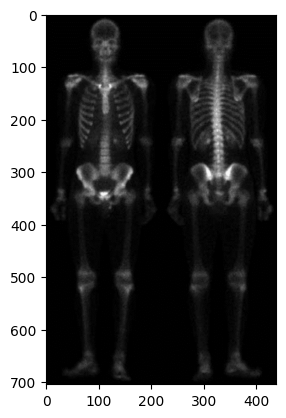

In [58]:
img8 = cv2.imread('../images/IMG8.png')
img8 = cv2.cvtColor(img8, cv2.COLOR_BGR2GRAY)
plt.imshow(cv2.cvtColor(img8, cv2.COLOR_GRAY2RGB))

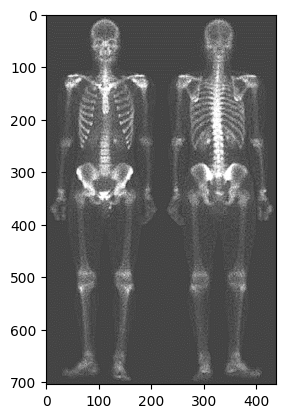

In [59]:
def gaussFilterGrayscale(img, k, sigma):
    img1 = np.zeros_like(img)
    kernel = generateGaussianKernel(k, sigma)
    kernel = kernel/np.sum(kernel)
    img1 = conv2D(img, kernel)
    return img1

res1 = gaussFilterGrayscale(img8, 5, 0.6)
res2 = np.zeros_like(res1)

blurred_img = gaussFilterGrayscale(res1, 5, 0.6)
mask = res1-blurred_img
sharpened_img = res1+1.5*mask
res2 = np.clip(sharpened_img, 0, 255).astype(np.uint8)
res3 = np.zeros_like(res2)
kernel = np.array([[0,  0, -1,  0, 0],
                    [0, -1, -2, -1, 0],
                    [-1, -2, 16, -2, -1],
                    [0, -1, -2, -1, 0],
                    [0,  0, -1,  0, 0]])
res3 = conv2D(res2, kernel)
res4 = cv2.convertScaleAbs(res3)
res5 = np.minimum(0.8*res2+0.2*res3, np.ones_like(res4)*255)
res6 = np.zeros_like(res5)
res6 = np.where(res5*2 > 255, 255, res5*2)
first_max = np.max(res6, axis=(0, 1))
first_min = np.min(res6, axis=(0, 1))
res7 = np.zeros_like(res6, dtype=np.uint8)
res7 = np.uint8((res6-first_min) / (first_max-first_min)*255)
plt.imshow(res7, cmap='gray')

The code first applies Gaussian filtering to reduce noise. Then, unsharp masking is used to enhance edges and details. A Laplacian kernel is used to further enhance edges. Finally, contrast stretching is applied to improve the overall appearance of the image.

### 8. You Can't See Me

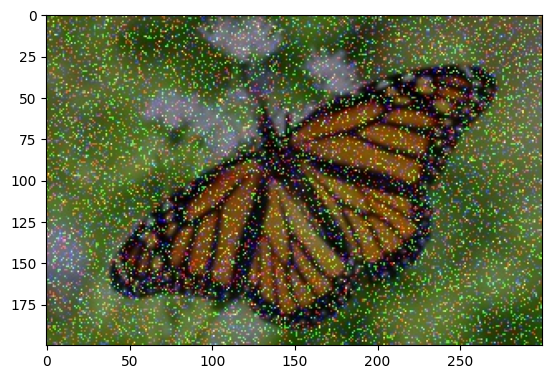

In [60]:
img9 = cv2.imread('../images/IMG9.jpg')
img9 = cv2.cvtColor(img9, cv2.COLOR_BGR2RGB)
plt.imshow(img9)

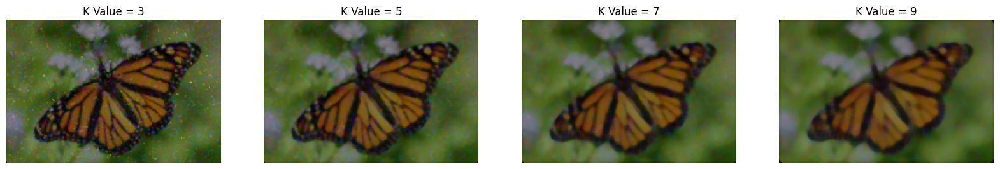

In [61]:
k_l = [3, 5, 7, 9]
plt.figure(figsize=(20, 5))
for i, k in enumerate(k_l):
    res = medianFilter(img9, k)
    plt.subplot(1, 4, i+1)
    plt.title(f'K Value = {k}')
    plt.imshow(res)
    plt.axis('off')

k = 7 works the best for the above step as it completely removes the noise in the image and at the same time not penalising image heavily as in the case of k = 9. So, we go by it.

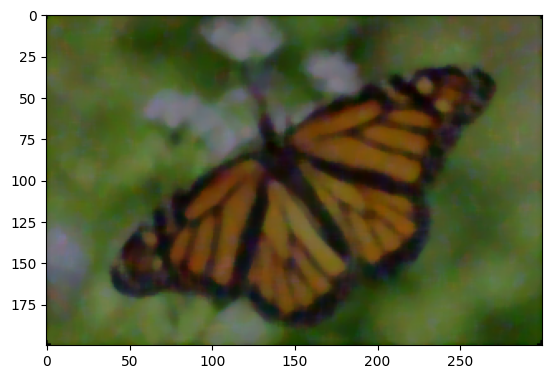

In [62]:
res = medianFilter(img9, 7)
plt.imshow(res)

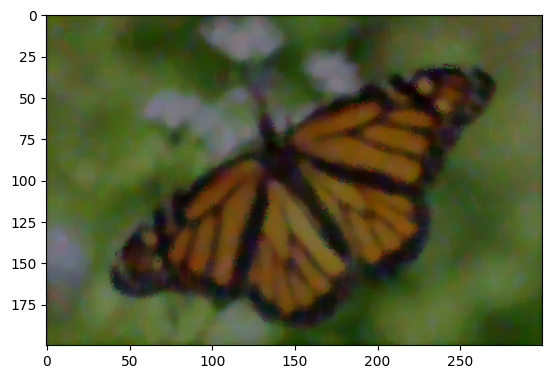

In [63]:
res2 = bilaterFilter(res, 9, 0.75, 0.75)
plt.imshow(res2)

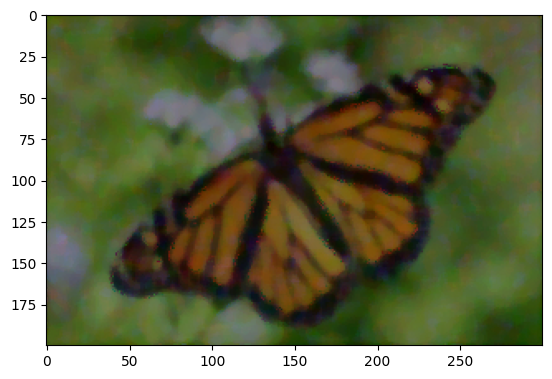

In [64]:
res3 = highboostFilter(res2, 5, 0.25, 1.5)
plt.imshow(res3)

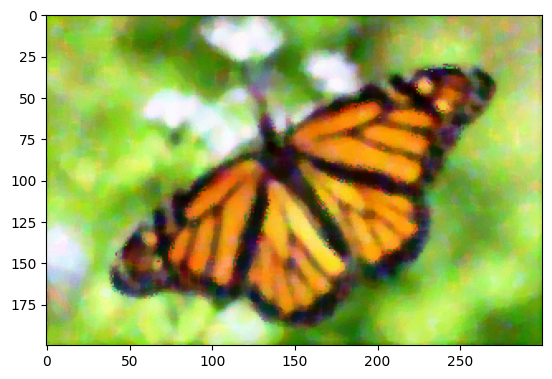

In [65]:
def histequalize(image):
    hist, bins = np.histogram(image.flatten(), 256, [0, 256])
    cdf = hist.cumsum()
    cdf_normalized = cdf * 255 / cdf[-1]
    image_equalized = np.interp(image.flatten(), bins[:-1], cdf_normalized)
    image_equalized = image_equalized.reshape(image.shape)
    return image_equalized.astype(np.uint8)

res4 = histequalize(res3)
plt.imshow(res4)

Steps involved in the Pipeline are as follows:
1. Median filtering: Median filtering replaces each pixel with the median value of its neighboring pixels which reduces salt-and-pepper noise while preserving edges.
2. Bilateral filtering:  The bilateral filter preserves edges while reducing noise by considering both spatial proximity and intensity similarity which results in preserving edges and reduces noise, especially for images with texture.
3. Highboost filtering: Highboost filtering enhances edges and details by amplifying high-frequency components, making the image sharper.
4. Histogram equalization: Improves contrast and enhances details.
By applying these techniques in sequence, the code aims to remove noise while maintaining the image's structural integrity and visual quality. The specific parameters used for each filter can be adjusted based on the characteristics of the image and the desired level of noise reduction.